## Loading the Data


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
from plotly.colors import qualitative
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
import pickle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier, XGBRFClassifier
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import (
    Dense,
    Dropout,
    BatchNormalization,
    Input,
    Concatenate,
    LSTM,
    Reshape,
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report,
    roc_auc_score,
    roc_curve,
    auc,
)

%matplotlib inline

In [2]:
# Read the dataset
df = pd.read_csv(
    "dataset/satisfaction.csv"
)  # From: https://www.kaggle.com/datasets/johndddddd/customer-satisfaction/data

df.head()

,id,satisfaction_v2,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,11112,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,110278,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,103199,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,47462,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,120011,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,...,4,2,2,0,2,4,2,5,0,0.0


In [3]:
# Display basic information about the dataset
print(f"Dataset Shape: {df.shape}")
print("Dataset Info:")
df.info()

Dataset Shape: (129880, 24)
Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129880 non-null  int64  
 1   satisfaction_v2                    129880 non-null  object 
 2   Gender                             129880 non-null  object 
 3   Customer Type                      129880 non-null  object 
 4   Age                                129880 non-null  int64  
 5   Type of Travel                     129880 non-null  object 
 6   Class                              129880 non-null  object 
 7   Flight Distance                    129880 non-null  int64  
 8   Seat comfort                       129880 non-null  int64  
 9   Departure/Arrival time convenient  129880 non-null  int64  
 10  Food and drink                     129880 non-null  int64  
 1

In [4]:
df.describe()  # Display basic statistics of the dataset

,id,Age,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129487.000000
mean,64940.500000,39.427957,1981.409055,2.838597,2.990645,2.851994,2.990422,3.249130,3.383477,3.519703,3.472105,3.465075,3.485902,3.695673,3.340807,3.705759,3.352587,14.713713,15.091129
std,37493.270818,15.119360,1027.115606,1.392983,1.527224,1.443729,1.305970,1.318818,1.346059,1.306511,1.305560,1.270836,1.292226,1.156483,1.260582,1.151774,1.298715,38.071126,38.465650
min,1.000000,7.000000,50.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32470.750000,27.000000,1359.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000,3.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,64940.500000,40.000000,1925.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,4.000000,0.000000,0.000000
75%,97410.250000,51.000000,2544.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000,5.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,129880.000000,85.000000,6951.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


In [5]:
print("Missing values in the dataset:")
df.isnull().sum()  # Check for missing values in the dataset

Missing values in the dataset:


id                                     0
satisfaction_v2                        0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Seat comfort                           0
Departure/Arrival time convenient      0
Food and drink                         0
Gate location                          0
Inflight wifi service                  0
Inflight entertainment                 0
Online support                         0
Ease of Online booking                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Cleanliness                            0
Online boarding                        0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
dtype: int64

In [6]:
# Check class distribution

print("Satisfaction distribution:")
print(df['satisfaction_v2'].value_counts(normalize=True))


Satisfaction distribution:
satisfaction_v2
satisfied                  0.547328
neutral or dissatisfied    0.452672
Name: proportion, dtype: float64


The target classes are pretty evenly distributed


## Data Preprocessing


In [7]:
# Dropping the id column as it is not necessary
df = df.drop(columns=["id"])

# Renaming the columns for better readability
df = df.rename(columns={"satisfaction_v2": "satisfaction"})
df = df.rename(
    columns={"Departure/Arrival time convenient": "departure_arrival_time_convenient"}
)

# Lowercase all column names and replace spaces with underscores
df.columns = df.columns.str.lower().str.replace(" ", "_")

df.head()

,satisfaction,gender,customer_type,age,type_of_travel,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,...,online_support,ease_of_online_booking,on-board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes
0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,...,4,2,2,0,2,4,2,5,0,0.0


In [8]:
# Drop rows with missing values
df = df.dropna(axis=0)
df.shape

(129487, 23)

There are a lot of 'object' type columns in the dataset. We will convert them to 'category' type used to store categorical data


In [9]:
# Convert object columns to categorcal columns
for col in df.columns:
    if df[col].dtype == "object":
        df[col] = df[col].astype("category")

df.dtypes

satisfaction                         category
gender                               category
customer_type                        category
age                                     int64
type_of_travel                       category
class                                category
flight_distance                         int64
seat_comfort                            int64
departure_arrival_time_convenient       int64
food_and_drink                          int64
gate_location                           int64
inflight_wifi_service                   int64
inflight_entertainment                  int64
online_support                          int64
ease_of_online_booking                  int64
on-board_service                        int64
leg_room_service                        int64
baggage_handling                        int64
checkin_service                         int64
cleanliness                             int64
online_boarding                         int64
departure_delay_in_minutes        

## Exploratory Data Analysis


In [10]:
# Check class distribution
print(df["satisfaction"].value_counts(normalize=True))

satisfaction
satisfied                  0.547406
neutral or dissatisfied    0.452594
Name: proportion, dtype: float64


In [11]:
# Convert categorical columns to numerical values
df_numeric = df.drop(columns=["satisfaction"]).apply(
    lambda x: pd.factorize(x)[0] if x.dtype.name == "category" else x
)

correlation_matrix = df_numeric.corr()

# Create a heatmap to visualize the correlation matrix
fig = px.imshow(
    correlation_matrix, text_auto=".2f", aspect="auto", color_continuous_scale="RdBu"
)
fig.update_layout(
    title="Correlation Matrix Heatmap",
    xaxis_title="Variables",
    yaxis_title="Variables",
    width=1200,  # Adjust the width
    height=800,  # Adjust the height
    font=dict(size=12),  # Adjust the font size
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/correlation_matrix_heatmap.png", width=960, height=540, scale=2)

In [12]:
# Extract pairs of features with strong positive correlations (>=0.6)
strong_positive_correlations = (
    correlation_matrix[(correlation_matrix >= 0.6) & (correlation_matrix < 1.0)]
    .stack()
    .reset_index()
)
strong_positive_correlations.columns = ["Feature 1", "Feature 2", "Correlation"]
strong_positive_correlations = strong_positive_correlations.sort_values(
    by="Correlation", ascending=False
)

# Eliminate duplicates based on the values in the Correlation column
strong_positive_correlations = strong_positive_correlations.drop_duplicates(subset=["Correlation"]).reset_index(drop=True)

strong_positive_correlations

,Feature 1,Feature 2,Correlation
0,departure_delay_in_minutes,arrival_delay_in_minutes,0.965291
1,seat_comfort,food_and_drink,0.716008
2,ease_of_online_booking,online_boarding,0.684329
3,online_support,online_boarding,0.669886
4,baggage_handling,cleanliness,0.632047
5,inflight_wifi_service,online_boarding,0.631800
6,online_support,ease_of_online_booking,0.617642
7,inflight_wifi_service,ease_of_online_booking,0.601074


In [13]:
# Create heatmap for strong correlations
mask = correlation_matrix >= 0.6
filtered_corr = correlation_matrix.mask(~mask)

fig = px.imshow(
    filtered_corr,
    text_auto=".2f",
    aspect="auto",
    color_continuous_scale="RdBu",
    range_color=[-1, 1]
)

fig.update_layout(
    title="Strong Correlations Heatmap (≥0.6)",
    xaxis_title="Features",
    yaxis_title="Features",
    width=1200,
    height=800,
    font=dict(size=12),
)

# Rotate x-axis labels for better readability
fig.update_xaxes(tickangle=45, tickmode='linear')
fig.update_yaxes(tickmode='linear')

# Add hover template
fig.update_traces(
    hovertemplate="Feature 1: %{x}<br>Feature 2: %{y}<br>Correlation: %{z:.2f}<extra></extra>"
)

fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/strong_correlations.png", width=960, height=540, scale=2)

In [14]:
# Let's check for the ratio of satisfied and unsatisfied customers
fig = px.pie(
    df,
    names="satisfaction",
    title="Satisfaction Distribution",
    color_discrete_sequence=px.colors.qualitative.Set3,
)
fig.show()

In [15]:
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/satisfaction_distribution.png", width=960, height=540, scale=2)

We can infer that the classes are pretty balanced


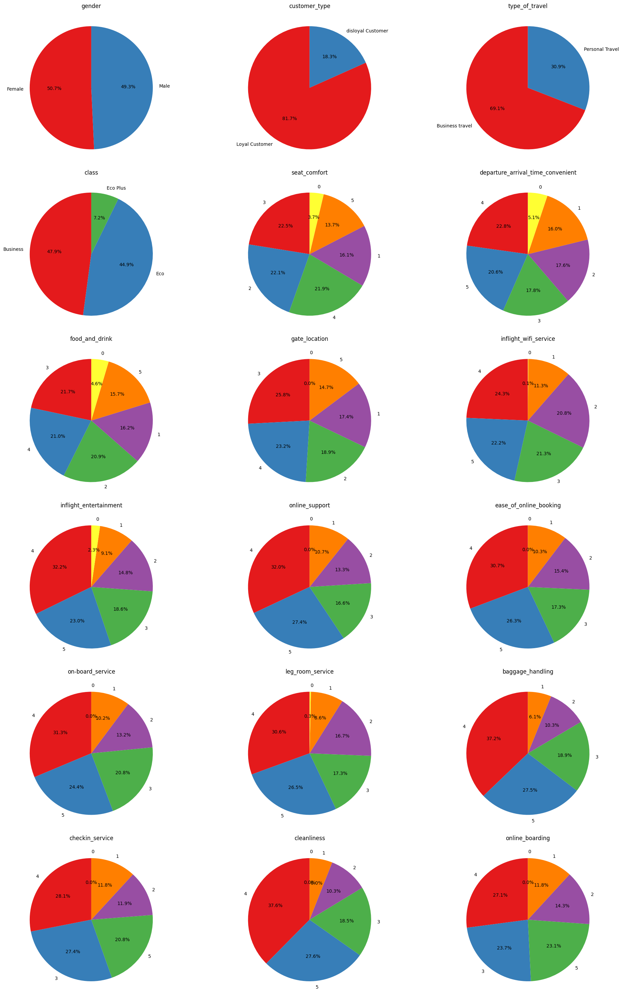

In [16]:
# Ratio of values of all the categorical columns
categorical_columns = [
    col
    for col in df.columns
    if col
    not in [
        "satisfaction",
        "age",
        "flight_distance",
        "departure_delay_in_minutes",
        "arrival_delay_in_minutes",
    ]
]
num_plots = len(categorical_columns)
num_cols = 3
num_rows = (num_plots + num_cols - 1) // num_cols

plt.figure(figsize=(20, num_rows * 5))
for i, col in enumerate(categorical_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.pie(df[col].value_counts(), labels=df[col].value_counts().index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette('Set1'))
    plt.title(f"{col}")
plt.tight_layout()
plt.savefig("graphs/ratio_of_values_of_all_categorical_columns.png", dpi=500, facecolor='#fffbf0')
plt.show()
# fig = make_subplots(
#     rows=num_rows,
#     cols=num_cols,
#     subplot_titles=categorical_columns,
#     specs=[[{"type": "domain"}] * num_cols] * num_rows,
# )
# for i, col in enumerate(categorical_columns):
#     pie_chart = px.pie(
#         df,
#         names=col,
#         title=f"{col}",
#         color_discrete_sequence=px.colors.qualitative.Set1,
#         labels={col: col},
#     )
#     pie_chart.update_traces(
#         textinfo="label+percent",
#         textposition="inside",
#         textfont_size=12,
#         textfont_color="black",
#         insidetextorientation="radial",
#     )

#     # Check if there are any small values that need to be highlighted
#     small_values = df[col].value_counts(normalize=True) * 100
#     small_values = small_values[small_values < 1]  # Threshold for small values
#     if not small_values.empty:
#         for value, percentage in small_values.items():
#             fig.add_annotation(
#                 x=(i % num_cols) / num_cols + 0.5 / num_cols,
#                 y=(num_rows - (i // num_cols) - 1) / num_rows + 0.5 / num_rows,
#                 text=f"{value}: {percentage:.2f}%",
#                 showarrow=False,
#                 font=dict(size=10, color="black"),
#                 bgcolor="white",
#                 opacity=0.8,
#             )

#     fig.add_trace(pie_chart.data[0], row=(i // num_cols) + 1, col=(i % num_cols) + 1)
# fig.update_layout(
#     title_text="Ratio of Values of All Categorical Columns",
#     showlegend=False,
#     height=num_rows * 500,
# )
# fig.show()


What we can infer:

- Gender is pretty evenly distributed
- There are more business travelers
- There is an almost equal distribution of Eco and Business class
- More than 60% of the customers are happy about baggage handling(4 and 5 ratings)
- More than 60% of the customers are happy about cleanliness(4 and 5 ratings)


In [17]:
# Age distribution by customer type
fig = make_subplots(
    rows=1,
    cols=2,
    subplot_titles=(
        "Boxplot of Age by Customer Type",
        "Histogram of Age by Customer Type",
    ),
)

boxplot = px.box(
    df,
    x="customer_type",
    y="age",
    color="customer_type",
    title="Boxplot of Age by Customer Type",
    color_discrete_sequence=qualitative.Bold,
    labels={"customer_type": "Customer Type", "age": "Age"}
)
histplot = px.histogram(
    df,
    x="age",
    color="customer_type",
    title="Histogram of Age by Customer Type",
    barmode="stack",
    color_discrete_sequence=qualitative.Bold,
    labels={"age": "Age", "customer_type": "Customer Type"}
)

for trace in boxplot.data:
    trace.showlegend = False
    fig.add_trace(trace, row=1, col=1)
for trace in histplot.data:
    fig.add_trace(trace, row=1, col=2)
fig.update_xaxes(title_text="Customer Type", row=1, col=1)
fig.update_yaxes(title_text="Age", row=1, col=1)
fig.update_xaxes(title_text="Age", row=1, col=2)
fig.update_yaxes(title_text="Count", row=1, col=2)
fig.update_layout(title_text="Age Distribution by Customer Type")
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/age_by_customer_type.png", width=960, height=540, scale=2)

So the majority of the loyal customers are in the age range of 30-50 years with the avrage being 43. Whereas the majority of the non-regular customers are in the age range of 20-40 years with the average being 27.


In [18]:
# Age distribution by class
fig = make_subplots(
    rows=1,
    cols=2,
    subplot_titles=("Boxplot of Age by Class", "Histogram of Age by Class"),
)

boxplot = px.box(
    df,
    x="class",
    y="age",
    color="class",
    title="Boxplot of Age by Class",
    color_discrete_sequence=qualitative.Bold,
)
histplot = px.histogram(
    df,
    x="age",
    color="class",
    title="Histogram of Age by Class",
    barmode="stack",
    color_discrete_sequence=qualitative.Bold,
)

for trace in boxplot.data:
    trace.showlegend = False
    fig.add_trace(trace, row=1, col=1)
for trace in histplot.data:
    fig.add_trace(trace, row=1, col=2)
fig.update_layout(
    title_text="Age Distribution by Class",
    xaxis_title="Class",
    yaxis_title="Age",
    xaxis2_title="Age",
    yaxis2_title="Count"
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/age_by_class.png", width=960, height=540, scale=2)

Inferring from the previus plot, we can see that it's the loyal/regular customers who travel often in business class

In [19]:
# Distribution of class across distance
fig = make_subplots(
    rows=1,
    cols=2,
    subplot_titles=(
        "Boxplot of Flight Distance by Class",
        "Histogram of Flight Distance by Class",
    ),
)

boxplot = px.box(
    df,
    x="class",
    y="flight_distance",
    color="class",
    title="Boxplot of Flight Distance by Class",
    color_discrete_sequence=qualitative.Bold,
)
histplot = px.histogram(
    df,
    x="flight_distance",
    color="class",
    title="Histogram of Flight Distance by Class",
    barmode="stack",
    color_discrete_sequence=qualitative.Bold,
)

for trace in boxplot.data:
    trace.showlegend = False  # Hide legend for boxplot
    fig.add_trace(trace, row=1, col=1)
for trace in histplot.data:
    fig.add_trace(trace, row=1, col=2)

fig.update_layout(
    title_text="Flight Distance Distribution by Class",
    xaxis_title="Class",
    yaxis_title="Flight Distance",
    xaxis2_title="Flight Distance",
    yaxis2_title="Count"
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/flight_distance_by_class.png", width=960, height=540, scale=2)

So for long distance travel, business class is the most preferred class.


In [ ]:
# Define a color mapping for the different ratings
color_mapping = {
    0: 'rgb(127, 60, 141)',
    1: 'rgb(17, 165, 121)',
    2: 'rgb(57, 105, 172)',
    3: 'rgb(242, 183, 1)',
    4: 'rgb(231, 63, 116)',
    5: 'rgb(128, 186, 90)'
}

# Flight distance with various in-flight services
fig = make_subplots(
    rows=2,
    cols=2,
    subplot_titles=(
        "Boxplot of Inflight Entertainment vs Flight Distance",
        "Histogram of Flight Distance by Inflight Entertainment",
        "Boxplot of Leg Room Service vs Flight Distance",
        "Histogram of Flight Distance by Leg Room Service",
    ),
)

# Create the boxplots and histograms with fixed colors
for rating in color_mapping.keys():
    boxplot1 = px.box(
        df[df['inflight_entertainment'] == rating],
        x="inflight_entertainment",
        y="flight_distance",
        color_discrete_sequence=[color_mapping[rating]],
        title="Boxplot of Inflight Entertainment vs Flight Distance"
    )
    histplot1 = px.histogram(
        df[df['inflight_entertainment'] == rating],
        x="flight_distance",
        color_discrete_sequence=[color_mapping[rating]],
        title="Histogram of Flight Distance by Inflight Entertainment",
        barmode="stack"
    )
    boxplot2 = px.box(
        df[df['leg_room_service'] == rating],
        x="leg_room_service",
        y="flight_distance",
        color_discrete_sequence=[color_mapping[rating]],
        title="Boxplot of Leg Room Service vs Flight Distance"
    )
    histplot2 = px.histogram(
        df[df['leg_room_service'] == rating],
        x="flight_distance",
        color_discrete_sequence=[color_mapping[rating]],
        title="Histogram of Flight Distance by Leg Room Service",
        barmode="stack"
    )

    for trace in boxplot1.data:
        trace.showlegend = False
        trace.name = f'Rating {rating}'
        fig.add_trace(trace, row=1, col=1)
    for trace in histplot1.data:
        trace.showlegend = False
        trace.name = f'Rating {rating}'
        fig.add_trace(trace, row=1, col=2)
    for trace in boxplot2.data:
        trace.showlegend = False
        trace.name = f'Rating {rating}'
        fig.add_trace(trace, row=2, col=1)
    for trace in histplot2.data:
        trace.showlegend = True
        trace.name = f'Rating {rating}'
        fig.add_trace(trace, row=2, col=2)

fig.update_layout(
    height=900,
    width=1200,
    title_text="Flight Distance Analysis",
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=-0.2,
        xanchor="center",
        x=0.5,
        traceorder="normal"
    ),
    xaxis_title="Inflight Entertainment",
    yaxis_title="Flight Distance",
    xaxis2_title="Flight Distance",
    yaxis2_title="Count",
    xaxis3_title="Leg Room Service",
    yaxis3_title="Flight Distance",
    xaxis4_title="Flight Distance",
    yaxis4_title="Count"
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/flight_distance_analysis.png", width=960, height=540, scale=2)

We can see here that longer the distance traveled by the customer, the more satisfied they are with the inflight amenities.

In [88]:
# Inflight wifi service vs satisfaction
fig = px.histogram(
    df,
    x='inflight_wifi_service',
    color='satisfaction',
    barmode='group',
    title='Inflight Wifi Service vs Satisfaction',
    labels={'inflight_wifi_service': 'Inflight Wifi Service', 'satisfaction': 'Satisfaction'},
    color_discrete_sequence=qualitative.Bold
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/inflight_wifi_service_vs_satisfaction.png", width=960, height=540, scale=2)

So the passengers who have rated the inflight wifi service highly are satisfied overall

In [89]:
# Seat Comfort and Leg Room Service vs Satisfaction
fig = make_subplots(rows=1, cols=2, subplot_titles=("Seat Comfort vs Satisfaction", "Leg Room Service vs Satisfaction"))

seat_comfort_plot = px.histogram(
    df,
    x='seat_comfort',
    color='satisfaction',
    barmode='group',
    title='Seat Comfort vs Satisfaction',
    labels={'seat_comfort': 'Seat Comfort', 'satisfaction': 'Satisfaction'},
    color_discrete_sequence=qualitative.Bold
)
for trace in seat_comfort_plot.data:
    fig.add_trace(trace, row=1, col=1)

leg_room_service_plot = px.histogram(
    df,
    x='leg_room_service',
    color='satisfaction',
    barmode='group',
    title='Leg Room Service vs Satisfaction',
    labels={'leg_room_service': 'Leg Room Service', 'satisfaction': 'Satisfaction'},
    color_discrete_sequence=qualitative.Bold
)
for trace in leg_room_service_plot.data:
    trace.showlegend = False  # Hide legend for the second plot
    fig.add_trace(trace, row=1, col=2)

fig.update_layout(
    title_text="Seat Comfort and Leg Room Service vs Satisfaction",
    showlegend=True,
    legend_title_text='Satisfaction',
    width=1000,
    height=500,
    xaxis=dict(title="Seat Comfort", tickmode='linear', dtick=1),
    yaxis=dict(title="Count"),
    xaxis2=dict(title="Leg Room Service", tickmode='linear', dtick=1),
    yaxis2=dict(title="Count")
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/seat_comfort_and_leg_room_service_vs_satisfaction.png", width=960, height=540, scale=2)

This paints an even clearer pciture that if th customers are happy with the seat and leg room service, they are satisfied with the flight

In [90]:
# Distribution of class with satisfaction
fig = px.histogram(
    df,
    x="class",
    color="satisfaction",
    barmode="group",
    title="Class Distribution with Satisfaction",
    color_discrete_sequence=px.colors.sequential.Agsunset,
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/class_with_satisfaction.png", width=960, height=540, scale=2)

We can clearly conclude that the people who travel in business class are more satisfied with the airline services than the people who travel in the others.


### ML Algorithms


In [23]:
df.dtypes

satisfaction                         category
gender                               category
customer_type                        category
age                                     int64
type_of_travel                       category
class                                category
flight_distance                         int64
seat_comfort                            int64
departure_arrival_time_convenient       int64
food_and_drink                          int64
gate_location                           int64
inflight_wifi_service                   int64
inflight_entertainment                  int64
online_support                          int64
ease_of_online_booking                  int64
on-board_service                        int64
leg_room_service                        int64
baggage_handling                        int64
checkin_service                         int64
cleanliness                             int64
online_boarding                         int64
departure_delay_in_minutes        

In [24]:
label_encoder = LabelEncoder()

for col in df.select_dtypes(
    include=["category"]
).columns:  # Iterate through all categorical columns
    df[col] = label_encoder.fit_transform(df[col])  # Fit and transform the column

with open("label_encoder.pkl", "wb") as file:
    pickle.dump(label_encoder, file)  # Save the label encoder to a file

df.head()

,satisfaction,gender,customer_type,age,type_of_travel,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,...,online_support,ease_of_online_booking,on-board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes
0,1,0,0,65,1,1,265,0,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,1,1,0,47,1,0,2464,0,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,1,0,0,15,1,1,2138,0,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,1,0,0,60,1,1,623,0,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,1,0,0,70,1,1,354,0,0,0,...,4,2,2,0,2,4,2,5,0,0.0


In [25]:
X = df.drop(columns=["satisfaction"])  # Features
y = df["satisfaction"]  # Target variable

In [26]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.15, random_state=12
)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((110063, 22), (19424, 22), (110063,), (19424,))

In [27]:
# Scale the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

### Logistic Regression


In [28]:
# Initialize the Logistic Regression model
model_lr = LogisticRegression(max_iter=1000)  # Create a Logistic Regression model
model_lr.fit(X_train, y_train)  # Train the model

y_pred_lr = model_lr.predict(X_test)  # Make predictions on the test set

In [29]:
accuracy_lr = accuracy_score(y_test, y_pred_lr) * 100  # Calculate the accuracy of the model
error_rate_lr = 100 - accuracy_lr  # Calculate the error rate of the model

print(f"Logistic Regression Model Accuracy: {accuracy_lr:.2f}")
print(f"Logistic Regression Model Error Rate: {error_rate_lr:.2f}")

classification_report_lr = classification_report(y_test, y_pred_lr)  # Generate the classification report
print("Classification Report:")
print(classification_report_lr)

confusion_matrix_lr = confusion_matrix(y_test, y_pred_lr)  # Generate the confusion matrix
print("Confusion Matrix:")
print(confusion_matrix_lr)


Logistic Regression Model Accuracy: 83.51
Logistic Regression Model Error Rate: 16.49
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.81      0.82      8855
           1       0.84      0.85      0.85     10569

    accuracy                           0.84     19424
   macro avg       0.83      0.83      0.83     19424
weighted avg       0.83      0.84      0.84     19424

Confusion Matrix:
[[7199 1656]
 [1547 9022]]


['aggrnyl', 'agsunset', 'algae', 'amp', 'armyrose', 'balance',
             'blackbody', 'bluered', 'blues', 'blugrn', 'bluyl', 'brbg',
             'brwnyl', 'bugn', 'bupu', 'burg', 'burgyl', 'cividis', 'curl',
             'darkmint', 'deep', 'delta', 'dense', 'earth', 'edge', 'electric',
             'emrld', 'fall', 'geyser', 'gnbu', 'gray', 'greens', 'greys',
             'haline', 'hot', 'hsv', 'ice', 'icefire', 'inferno', 'jet',
             'magenta', 'magma', 'matter', 'mint', 'mrybm', 'mygbm', 'oranges',
             'orrd', 'oryel', 'oxy', 'peach', 'phase', 'picnic', 'pinkyl',
             'piyg', 'plasma', 'plotly3', 'portland', 'prgn', 'pubu', 'pubugn',
             'puor', 'purd', 'purp', 'purples', 'purpor', 'rainbow', 'rdbu',
             'rdgy', 'rdpu', 'rdylbu', 'rdylgn', 'redor', 'reds', 'solar',
             'spectral', 'speed', 'sunset', 'sunsetdark', 'teal', 'tealgrn',
             'tealrose', 'tempo', 'temps', 'thermal', 'tropic', 'turbid',
             'turbo', 'twilight', 'viridis', 'ylgn', 'ylgnbu', 'ylorbr',
             'ylorrd'].

In [116]:
# Plot the confusion matrix using Plotly
confusion_matrix_fig_lr = px.imshow(
    confusion_matrix_lr,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
)

confusion_matrix_fig_lr.update_layout(title="Confusion Matrix for Logistic Regression")
confusion_matrix_fig_lr.show()
confusion_matrix_fig_lr.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig_lr.write_image("graphs/confusion_matrix_lr.png", width=960, height=540, scale=2)

### K Nearest Neighbors


In [117]:
#  Train the model
knn_accuracies = []
knn_models = {}

for k in range(2, 16):
    model_knn = KNeighborsClassifier(n_neighbors=k)
    model_knn.fit(X_train, y_train)
    y_pred_knn = model_knn.predict(X_test)

    accuracy_knn = accuracy_score(y_test, y_pred_knn) * 100
    knn_accuracies.append(accuracy_knn)
    knn_models[k] = model_knn

    print(f"KNN Model with k={k} Accuracy: {accuracy_knn:.2f}")
    print("Classification Report:")
    print(classification_report(y_test, y_pred_knn))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred_knn))
    print("\n")

KNN Model with k=2 Accuracy: 90.66
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.97      0.90      8855
           1       0.97      0.86      0.91     10569

    accuracy                           0.91     19424
   macro avg       0.91      0.91      0.91     19424
weighted avg       0.91      0.91      0.91     19424

Confusion Matrix:
[[8565  290]
 [1525 9044]]


KNN Model with k=3 Accuracy: 92.14
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.93      0.92      8855
           1       0.94      0.91      0.93     10569

    accuracy                           0.92     19424
   macro avg       0.92      0.92      0.92     19424
weighted avg       0.92      0.92      0.92     19424

Confusion Matrix:
[[8246  609]
 [ 917 9652]]


KNN Model with k=4 Accuracy: 91.77
Classification Report:
              precision    recall  f1-score   support

           0       0.87

In [122]:
# Determine the best k value
best_k = (
    knn_accuracies.index(max(knn_accuracies)) + 2
)  # Adding 2 because k starts from 2

# Plot the confusion matrix for the best k value
best_knn_model = knn_models[best_k]
y_pred_best_knn = best_knn_model.predict(X_test)

accuracy_best_knn = accuracy_score(y_test, y_pred_best_knn) * 100
error_rate_best_knn = 100 - accuracy_best_knn

print(f"KNN Model with k={best_k} Accuracy: {accuracy_best_knn:.2f}")
print(f"KNN Model with k={best_k} Error Rate: {error_rate_best_knn:.2f}")

classification_report_best_knn = classification_report(y_test, y_pred_best_knn)
print("Classification Report:")
print(classification_report_best_knn)

# Plotting the elbow curve
fig = px.line(
    x=list(range(2, 16)),
    y=knn_accuracies,
    markers=True,
    title="Elbow Curve for KNN",
    labels={"x": "Number of Neighbors (k)", "y": "Accuracy (%)"},
)
fig.update_layout(xaxis=dict(tickmode="linear", tick0=2, dtick=1))

# Highlight the k value with the highest accuracy
max_accuracy = max(knn_accuracies)
best_k = knn_accuracies.index(max_accuracy) + 2  # Adding 2 because k starts from 2

fig.add_annotation(
    x=best_k,
    y=max_accuracy,
    text=f"Best k={best_k}<br>Accuracy={max_accuracy:.2f}%",
    showarrow=True,
    arrowhead=2,
    ax=0,
    ay=-40,
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/elbow_curve_knn.png", width=960, height=540, scale=2)

confusion_matrix_knn = confusion_matrix(y_test, y_pred_best_knn)
confusion_matrix_fig_knn = px.imshow( # Plot the confusion matrix
    confusion_matrix_knn,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
)

confusion_matrix_fig_knn.update_layout(title=f"Confusion Matrix for KNN (k={best_k})")
confusion_matrix_fig_knn.show()
confusion_matrix_fig_knn.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig_knn.write_image("graphs/confusion_matrix_knn.png", width=960, height=540, scale=2)

KNN Model with k=9 Accuracy: 92.48
KNN Model with k=9 Error Rate: 7.52
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      8855
           1       0.95      0.91      0.93     10569

    accuracy                           0.92     19424
   macro avg       0.92      0.93      0.92     19424
weighted avg       0.93      0.92      0.92     19424



### Decision Tree


In [131]:
# Initialize the Decision Tree model
model_dt = DecisionTreeClassifier(criterion="entropy", max_depth=20)  # Create a Decision Tree model
model_dt.fit(X_train, y_train)  # Train the model

y_pred_dt = model_dt.predict(X_test)  # Make predictions on the test set

In [135]:
accuracy_dt = (
    accuracy_score(y_test, y_pred_dt)
) * 100  # Calculate the accuracy of the model
error_rate_dt = 100 - accuracy_dt  # Calculate the error rate of the model
print(f"Decision Tree Model Accuracy: {accuracy_dt:.2f}")
print(f"Decision Tree Model Error Rate: {error_rate_dt:.2f}")

classification_report_dt = classification_report(
    y_test, y_pred_dt
)  # Generate the classification report
print("Classification Report:")
print(classification_report_dt)

confusion_matrix_dt = confusion_matrix(
    y_test, y_pred_dt
)  # Generate the confusion matrix

fig = px.imshow(
    confusion_matrix_dt,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
    title="Confusion Matrix for Decision Tree",
)
fig.write_image("graphs/confusion_matrix_dt.png")
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/confusion_matrix_dt.png", width=960, height=540, scale=2)

Decision Tree Model Accuracy: 94.96
Decision Tree Model Error Rate: 5.04
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.95      0.95      8855
           1       0.96      0.95      0.95     10569

    accuracy                           0.95     19424
   macro avg       0.95      0.95      0.95     19424
weighted avg       0.95      0.95      0.95     19424



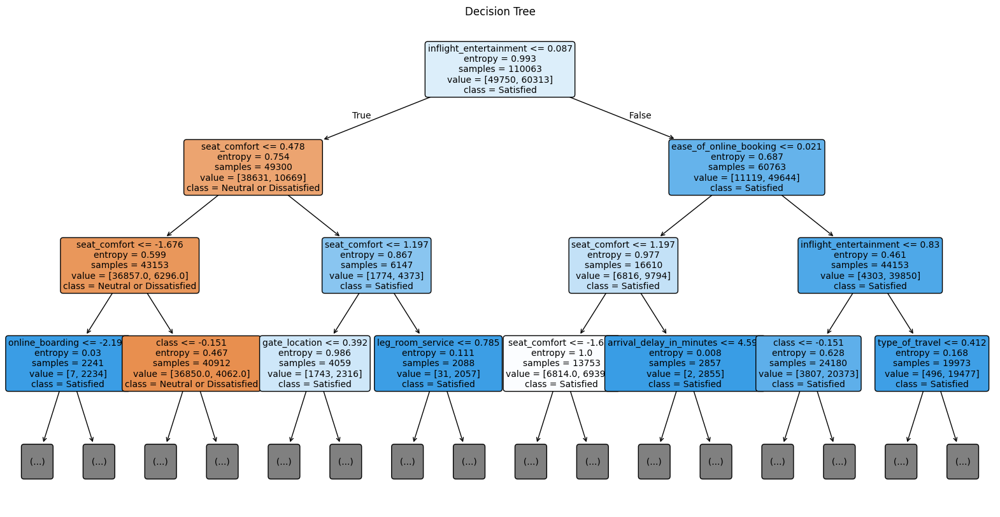

In [138]:
# Plot the tree
from sklearn.tree import plot_tree
from sklearn.tree import export_text
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 10))
plot_tree(
    model_dt,
    feature_names=X.columns,
    class_names=["Neutral or Dissatisfied", "Satisfied"],
    filled=True,
    rounded=True,
    fontsize=10,
    max_depth=3,
)
plt.title("Decision Tree")
plt.savefig("graphs/decision_tree.png", facecolor='#fffbf0', dpi=200)
plt.show()
# Export the decision tree rules as text
tree_rules_dt = export_text(model_dt, feature_names=list(X.columns))

with open("decision_tree_rules.txt", "w") as file:
    file.write(tree_rules_dt)

### Random Forest Classifier


In [177]:
# Initialize the Random Forest model
model_rf = RandomForestClassifier(n_estimators=500, criterion="log_loss", max_depth=20)  # Create a Random Forest model
model_rf.fit(X_train, y_train)  # Train the model

y_pred_rf = model_rf.predict(X_test)  # Make predictions on the test set

In [178]:
accuracy_rf = (
    accuracy_score(y_test, y_pred_rf)
) * 100  # Calculate the accuracy of the model
error_rate_rf = 100 - accuracy_rf  # Calculate the error rate of the model
print(f"Random Forest Model Accuracy: {accuracy_rf:.2f}")
print(f"Random Forest Model Error Rate: {error_rate_rf:.2f}")

classification_report_rf = classification_report(
    y_test, y_pred_rf
)  # Generate the classification report
print("Classification Report:")
print(classification_report_rf)

confusion_matrix_rf = confusion_matrix(
    y_test, y_pred_rf
)  # Generate the confusion matrix

confusion_matrix_fig_rf = px.imshow(
    confusion_matrix_rf,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
    title="Confusion Matrix for Random Forest",
)
confusion_matrix_fig_rf.show()
confusion_matrix_fig_rf.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig_rf.write_image("graphs/confusion_matrix_rf.png", width=960, height=540, scale=2)

# Show the feature importances
feature_importances_rf = model_rf.feature_importances_

# Create a DataFrame to store the feature importances
feature_importances_df = pd.DataFrame(
    {"Features": X.columns, "Importance": feature_importances_rf}
)
feature_importances_df = feature_importances_df.sort_values(
    by="Importance", ascending=False
)

# Plot the feature importances
fig = px.bar(
    feature_importances_df,
    x="Features",
    y="Importance",
    orientation="v",
    title="Feature Importances for Random Forest",
)
fig.update_layout(
    xaxis=dict(
        tickmode='linear',
        dtick=1
    )
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/feature_importances_rf.png", width=960, height=540, scale=2)

Random Forest Model Accuracy: 95.91
Random Forest Model Error Rate: 4.09
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.96      0.96      8855
           1       0.97      0.96      0.96     10569

    accuracy                           0.96     19424
   macro avg       0.96      0.96      0.96     19424
weighted avg       0.96      0.96      0.96     19424



### Support Vector Machine


In [38]:
# Initialize the SVM Model
model_svm = SVC()
model_svm.fit(X_train, y_train)

y_pred_svm = model_svm.predict(X_test)

In [180]:
accuracy_svm = (
    accuracy_score(y_test, y_pred_svm)
) * 100  # Calculate the accuracy of the model
error_rate_svm = 100 - accuracy_svm  # Calculate the error rate of the model
print(f"SVC Model Accuracy: {accuracy_svm:.2f}")
print(f"SVC Model Error Rate: {error_rate_svm:.2f}")

classification_report_svm = classification_report(
    y_test, y_pred_svm
)  # Generate the classification report
print("Classification Report:")
print(classification_report_svm)

confusion_matrix_svm = confusion_matrix(
    y_test, y_pred_svm
)  # Generate the confusion matrix
# Plot the confusion matrix using Plotly
fig = px.imshow(
    confusion_matrix_svm,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
)

fig.update_layout(title="Confusion Matrix for SVC")
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/confusion_matrix_svm.png", width=960, height=540, scale=2)

SVC Model Accuracy: 94.88
SVC Model Error Rate: 5.12
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      8855
           1       0.95      0.95      0.95     10569

    accuracy                           0.95     19424
   macro avg       0.95      0.95      0.95     19424
weighted avg       0.95      0.95      0.95     19424



### Deep Learning with Long Short Term Memory(LSTM) Model

In [184]:
# Initialize the LSTM Model
model_lstm = Sequential(
    [
        Input(shape=(X_train.shape[1],)),
        Dense(64, activation="relu"),
        Dense(32, activation="relu"),
        Reshape((32, 1)),  # Reshape to a compatible dimension
        LSTM(50, return_sequences=True),
        LSTM(25),
        Dense(2, activation="softmax"),
    ]
)

model_lstm.compile(
    optimizer=Adam(learning_rate=0.001),
    loss="binary_crossentropy",
    metrics=["accuracy"],
)

early_stop = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)

# Convert y_train to one-hot encoded format
y_train_categorical = to_categorical(y_train)

model_lstm.fit(
    X_train,
    y_train_categorical,
    validation_split=0.1,
    epochs=100,
    batch_size=32,
    callbacks=[early_stop],
    verbose=1,
)

Epoch 1/100
3096/3096 [==============================] - 53s 16ms/step - loss: 0.2053 - accuracy: 0.9132 - val_loss: 0.1501 - val_accuracy: 0.9380
Epoch 2/100
3096/3096 [==============================] - 49s 16ms/step - loss: 0.1444 - accuracy: 0.9384 - val_loss: 0.1366 - val_accuracy: 0.9407
Epoch 3/100
3096/3096 [==============================] - 49s 16ms/step - loss: 0.1284 - accuracy: 0.9437 - val_loss: 0.1274 - val_accuracy: 0.9494
Epoch 4/100
3096/3096 [==============================] - 49s 16ms/step - loss: 0.1194 - accuracy: 0.9477 - val_loss: 0.1276 - val_accuracy: 0.9447
Epoch 5/100
3096/3096 [==============================] - 49s 16ms/step - loss: 0.1146 - accuracy: 0.9490 - val_loss: 0.1240 - val_accuracy: 0.9488
Epoch 6/100
3096/3096 [==============================] - 49s 16ms/step - loss: 0.1110 - accuracy: 0.9512 - val_loss: 0.1151 - val_accuracy: 0.9514
Epoch 7/100
3096/3096 [==============================] - 48s 16ms/step - loss: 0.1077 - accuracy: 0.9521 - val_loss: 0

In [194]:
model_lstm.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 64)                1472      
                                                                 
 dense_13 (Dense)            (None, 32)                2080      
                                                                 
 reshape_4 (Reshape)         (None, 32, 1)             0         
                                                                 
 lstm_8 (LSTM)               (None, 32, 50)            10400     
                                                                 
 lstm_9 (LSTM)               (None, 25)                7600      
                                                                 
 dense_14 (Dense)            (None, 2)                 52        
                                                                 
Total params: 21,604
Trainable params: 21,604
Non-trai

In [195]:
accuracy_lstm = model_lstm.evaluate(X_test, to_categorical(y_test))[1] * 100
error_rate_lstm = 100 - accuracy_lstm
print(f"LSTM Model Accuracy: {accuracy_lstm:.2f}")
print(f"LSTM Model Error Rate: {error_rate_lstm:.2f}")

y_pred_lstm = model_lstm.predict(X_test)
y_pred_lstm = np.argmax(y_pred_lstm, axis=1)

classification_report_lstm = classification_report(y_test, y_pred_lstm)
print("Classification Report:")
print(classification_report_lstm)

confusion_matrix_lstm = confusion_matrix(y_test, y_pred_lstm)

confusion_matrix_fig = px.imshow(
    confusion_matrix_lstm,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
    title="Confusion Matrix for ANN(LSTM) Model",
)
confusion_matrix_fig.show()
confusion_matrix_fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig.write_image("graphs/confusion_matrix_lstm.png", width=960, height=540, scale=2)

607/607 [==============================] - 6s 10ms/step - loss: 0.1023 - accuracy: 0.9588
LSTM Model Accuracy: 95.88
LSTM Model Error Rate: 4.12
607/607 [==============================] - 3s 6ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8855
           1       0.98      0.95      0.96     10569

    accuracy                           0.96     19424
   macro avg       0.96      0.96      0.96     19424
weighted avg       0.96      0.96      0.96     19424



In [186]:
# Plot the ROC for LSTM
fpr, tpr, _ = roc_curve(y_test, y_pred_lstm)
roc_auc = auc(fpr, tpr)

fig = px.area(
    x=fpr,
    y=tpr,
    title=f"ROC Curve (AUC={roc_auc:.4f})",
    labels=dict(x="False Positive Rate", y="True Positive Rate"),
    width=700,
    height=500,
)
fig.add_shape(type="line", line=dict(dash="dash"), x0=0, x1=1, y0=0, y1=1)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/roc_curve_lstm.png", width=960, height=540, scale=2)

### AdaBoost

In [40]:
# Initialize the AdaBoost Model
model_ada = AdaBoostClassifier(n_estimators=1000, learning_rate=0.1, algorithm="SAMME")
model_ada.fit(X_train, y_train)

y_pred_ada = model_ada.predict(X_test)  # Make predictions on the test set

In [193]:
accuracy_ada = (
    accuracy_score(y_test, y_pred_ada)
) * 100  # Calculate the accuracy of the model
error_rate_ada = 100 - accuracy_ada  # Calculate the error rate of the model
print(f"AdaBoost Model Accuracy: {accuracy_ada:.2f}")
print(f"AdaBoost Model Error Rate: {error_rate_ada:.2f}")

classification_report_ada = classification_report(
    y_test, y_pred_ada
)  # Generate the classification report
print("Classification Report:")
print(classification_report_ada)

confusion_matrix_ada = confusion_matrix(
    y_test, y_pred_ada
)  # Generate the confusion matrix
# Plot the confusion matrix using Plotly
confusion_matrix_fig = px.imshow(
    confusion_matrix_ada,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
)
confusion_matrix_fig.update_layout(title="Confusion Matrix for AdaBoost")
confusion_matrix_fig.show()
confusion_matrix_fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig.write_image("graphs/confusion_matrix_ada.png", width=960, height=540, scale=2)

# Feature importances for AdaBoost
feature_importances_ada = model_ada.feature_importances_

# Create a DataFrame to store the feature importances
feature_importances_df = pd.DataFrame(
    {"Feature": X.columns, "Importance": feature_importances_ada}
)
feature_importances_df = feature_importances_df.sort_values(
    by="Importance", ascending=False
)

# Plot the feature importances
fig = px.bar(
    feature_importances_df,
    x="Feature",
    y="Importance",
    orientation="v",
    title="Feature Importances for AdaBoost",
)
fig.update_layout(
    xaxis=dict(
        tickmode='linear',
        dtick=1
    )
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/feature_importances_ada.png", width=960, height=540, scale=2)

AdaBoost Model Accuracy: 88.47
AdaBoost Model Error Rate: 11.53
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.87      8855
           1       0.90      0.89      0.89     10569

    accuracy                           0.88     19424
   macro avg       0.88      0.88      0.88     19424
weighted avg       0.88      0.88      0.88     19424



### eXtreme Gradient Boosting


In [42]:
# Initialize the XGBoost Model
model_xgb = XGBClassifier(
    n_estimators=2000,
    learning_rate=0.05,
    max_depth=12,
    subsample=0.9,
    colsample_bytree=0.9,
)
model_xgb.fit(X_train, y_train)

y_pred_xgb = model_xgb.predict(X_test)  # Make predictions on the test set

In [192]:
accuracy_xgb = (
    accuracy_score(y_test, y_pred_xgb)
) * 100  # Calculate the accuracy of the model
error_rate_xgb = 100 - accuracy_xgb  # Calculate the error rate of the model
print(f"XGBoost Model Accuracy: {accuracy_xgb:.2f}")
print(f"XGBoost Model Error Rate: {error_rate_xgb:.2f}")

classification_report_xgb = classification_report(
    y_test, y_pred_xgb
)  # Generate the classification report
print("Classification Report:")
print(classification_report_xgb)

confusion_matrix_xgb = confusion_matrix(
    y_test, y_pred_xgb
)  # Generate the confusion matrix

confusion_matrix_fig = px.imshow(
    confusion_matrix_xgb,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=["Neutral or Dissatisfied", "Satisfied"],
    y=["Neutral or Dissatisfied", "Satisfied"],
    text_auto=True,
    color_continuous_scale="sunsetdark",
    title="Confusion Matrix for XGBoost",
)
confusion_matrix_fig.show()
confusion_matrix_fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
confusion_matrix_fig.write_image("graphs/confusion_matrix_xgb.png", width=960, height=540, scale=2)

feature_importances_xgb = model_xgb.feature_importances_

# Create a DataFrame to store the feature importances
feature_importances_df = pd.DataFrame(
    {"Feature": X.columns, "Importance": feature_importances_xgb}
)
feature_importances_df = feature_importances_df.sort_values(
    by="Importance", ascending=False
)

# Plot the feature importances
fig = px.bar(
    feature_importances_df,
    x="Feature",
    y="Importance",
    orientation="v",
    title="Feature Importances for XG Boost",
)
fig.update_layout(
    xaxis=dict(
        tickmode='linear',
        dtick=1
    )
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/feature_importances_xgb.png", width=960, height=540, scale=2)

XGBoost Model Accuracy: 96.04
XGBoost Model Error Rate: 3.96
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.96      0.96      8855
           1       0.97      0.96      0.96     10569

    accuracy                           0.96     19424
   macro avg       0.96      0.96      0.96     19424
weighted avg       0.96      0.96      0.96     19424



In [ ]:
# Plot the ROC for all models
models = {
    "Logistic Regression": y_pred_lr,
    "KNN": y_pred_best_knn,
    "Decision Tree": y_pred_dt,
    "Random Forest": y_pred_rf,
    "SVC": y_pred_svm,
    "AdaBoost": y_pred_ada,
    "LSTM": y_pred_lstm,
    "XGBoost": y_pred_xgb,
}

# Colors for each model
colors = ["blue", "magenta", "green", "purple", "orange", "brown", "gray", "red"]

# Create figure
fig = go.Figure()

# Add ROC curves for each model
for (name, y_pred), color in zip(models.items(), colors):
    fpr, tpr, _ = roc_curve(y_test, y_pred)
    roc_auc = auc(fpr, tpr)
    fig.add_trace(
        go.Scatter(
            x=fpr,
            y=tpr,
            name=f"{name} (AUC={roc_auc:.3f})",
            line=dict(color=color, width=2),
        )
    )

# Add diagonal line
fig.add_shape(type="line", line=dict(dash="dash"), x0=0, x1=1, y0=0, y1=1)

# Update layout
fig.update_layout(
    title="ROC Curves Comparison - All Models",
    xaxis_title="False Positive Rate",
    yaxis_title="True Positive Rate",
    width=800,
    height=600,
    showlegend=True,
    legend=dict(yanchor="bottom", y=0.01, xanchor="right", x=0.99, bgcolor="rgba(255, 255, 255, 0.5)"),
    template="plotly",
)
fig.show()
fig.update_layout(paper_bgcolor="rgb(255, 251, 240)")
fig.write_image("graphs/roc_curves_comparison.png", width=960, height=540, scale=2)